### Test mutual information on Hawkes and Poisson Process Simulations
The prupose of this notebook is to showcase that the conditional and mutual information calculations are valid and correct. We also attempt to show how the calculations perform on various count scales and different underlying generating process.

Process we look at are:
- Homogoneous Poisson Process (Constant Lambda)
- Imhomogoneous Poisson Process
    - Random Varying Lambda
    - Periodic Lambda
    - Seasonal + Trend + Residual Process
- Imhomogoneous Poisson Process + Autoregressive Signals
- Simmulated Hawkes Process (Generated by Thinning Algorithm)
- Signals with exponential outliers like most data is between 0 and 10 but an outlier is 100.

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from models.baseline_models import UniformMovingAverage, TriangularMovingAverage, ExponentialMovingAverage
from utils.plots import plot
import pandas as pd
from utils.plots import plot_time_signals
from utils.utils import shift
import scipy as sp
from utils.rolling import periodic_rolling
from IPython.display import display
from utils.data_processing import to_percentile
from utils.mutual_information_plots import plot_mi 
from utils.plots import plot_autocorr
from utils.utils import cut

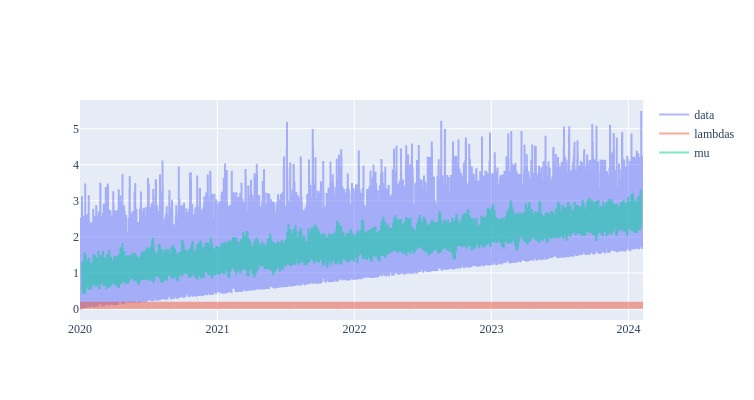

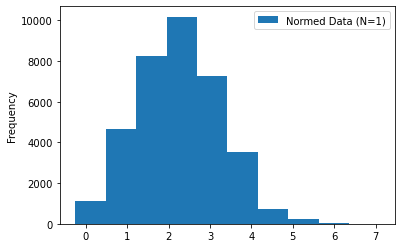

In [72]:
period = 24
n = period*1500
window = 11
center = True
lambdas = np.ones(n)*.3
lambdas = .1*(np.sin(2*np.pi*(np.arange(n)%period)/period) + 1) + 1e-3
# lambdas = 1*(np.arange(n)%period)/period

decay = np.exp(-1*np.linspace(0.1,1,n))
# lambdas = decay*(lambdas + 1)

date_range = pd.date_range('2020',freq='H', periods=n)


# generate sampels
summed_data = []
summed_lambdas = []
num_samples = 1

rand_w = [1] # np.random.rand(num_samples)
for i in range(num_samples):
    summed_lambdas.append(rand_w[i]*lambdas)
    
    # first samples
    data = sp.stats.poisson.rvs(rand_w[i]*lambdas)
    
    # self-exciting samples
    data =  data + .1*(sp.stats.poisson.rvs(np.roll(data,1)) +
                       sp.stats.poisson.rvs(np.roll(data,13)) +
                       sp.stats.poisson.rvs(np.roll(data,19)))
    
    # trend line
    trend = .5*np.max(data)*(np.arange(n)/n+np.random.rand(n))
    data = data + trend
    
    summed_data.append(data)
    
data = np.array(summed_data).sum(0)
lambdas = np.array(summed_lambdas).sum(0)

# data = np.cumsum(np.random.randn(n))
# data = lambdas

mu = periodic_rolling(
    func=np.mean,
    data=data,
    window=window,
    period=period,
    center=center,
    fill=np.nan,
)

std = periodic_rolling(
    func=np.std,
    data=data,
    window=window,
    period=period,
    center=center,
)

plot_time_signals(
    t_range=date_range,
    data=data, 
    lambdas=lambdas,
    mu=mu,
).show()

# test if data is normal depending on the number of underlying point process
normed_data = pd.DataFrame(data=(data-lambdas),columns=[f'Normed Data (N={num_samples})'])
normed_data = normed_data / normed_data.std()
normed_data.plot(kind='hist')
plt.show()

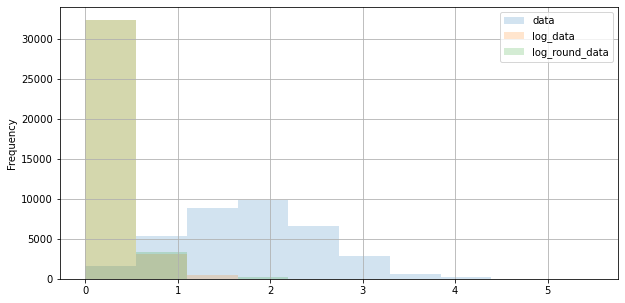

In [73]:
df = pd.DataFrame(data=dict(
    data=data,
    log_data=log_data,
    log_round_data=log_round_data, 
))
ax = df.plot(kind='hist',alpha=0.2)
ax.figure.set_size_inches(10,5)
plt.grid()
plt.show()

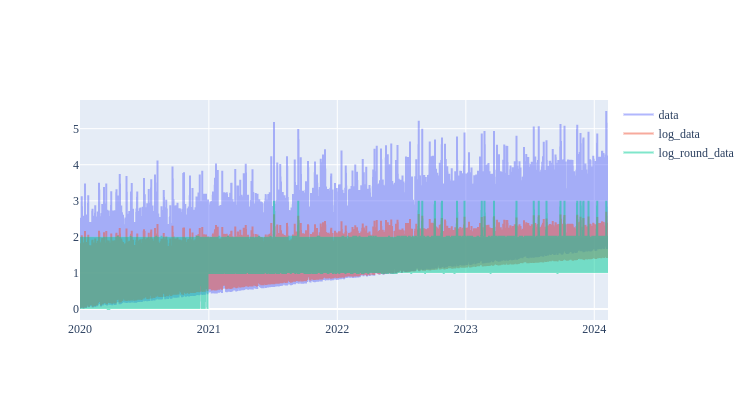

<Figure size 720x720 with 0 Axes>

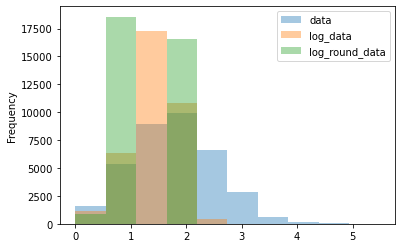

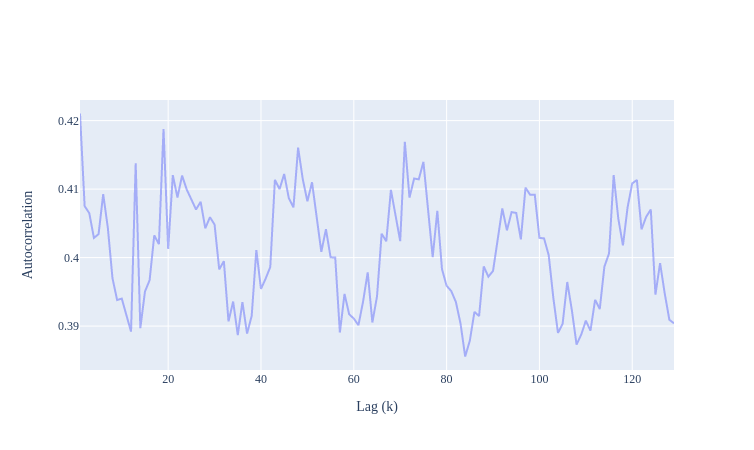

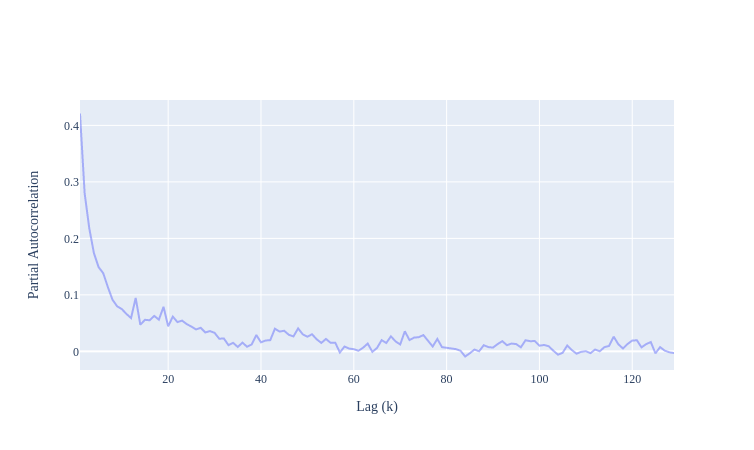

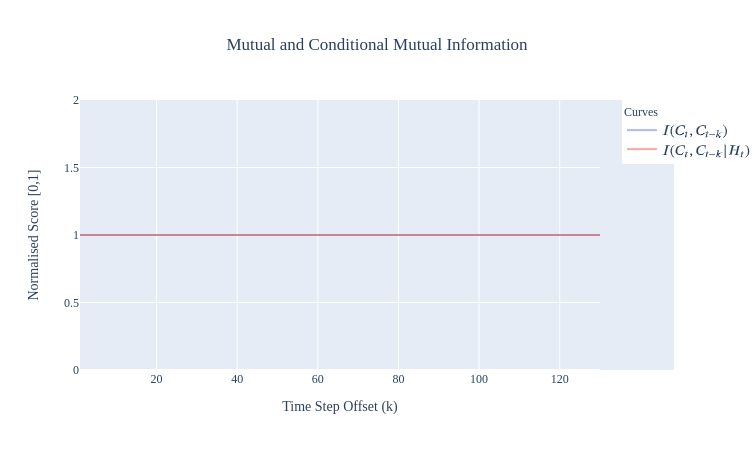

In [74]:
from utils.mutual_information_plots import plot_mi_curves, subplot_mi_curves
from utils.plots import plot_autocorr
from statsmodels.tsa.stattools import acf, pacf
from utils.rolling import rolling_norm

log_data = np.log2(1 + data)
log_round_data = np.round(np.log2(1 + data))
scaled_data = data

plot_time_signals(
    t_range=date_range,
    data=data,
    log_data=log_data,
    log_round_data=log_round_data, 
).show()

plt.figure(figsize=(10,10))
pd.DataFrame(data=dict(
    data=data,
    log_data=log_data,
    log_round_data=log_round_data, 
)).plot(kind='hist',alpha=0.4)
plt.show()

nlags = 130

plot_autocorr(data=scaled_data, max_offset=nlags).show()
plot_autocorr(data=scaled_data, max_offset=nlags, partial=True).show()

mutual_info_bins = 0 # int(np.ceil(np.max(data)+1))

plot_mi_curves(
    t_range=date_range,
    a=scaled_data,
    max_offset=nlags,
    norm=True,
    log_norm=False,
    bins=mutual_info_bins,
    temporal_variables=['Hour'],
).show()

---

In [1]:
from sparse_discrete_table import SparseDiscreteTable, build_discrete_table
from ipywidgets import widgets
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import plotly.graph_objects as go

In [2]:
def plot(y, x, mode='lines+markers'):
#     x = np.arange(len(y))
        
    data = [go.Scatter(x=x,y=y,mode=mode)]
    layout = dict(width=900,height=400)
    return go.FigureWidget(data=data, layout=layout)

In [3]:
def run_trails(fn, fn_kwargs, ntrails):
    trails = []
    for n in range(ntrails):
        obs = fn(**fn_kwargs)
        mi = gen_mi(obs)
        trails.append(mi)
    return trails

In [4]:
from tick.plot import plot_point_process
from tick.hawkes import SimuHawkes, HawkesKernelSumExp
from scipy.stats import poisson


def gen_hawkes(baseline, intensity, decay, run_time):
    hawkes = SimuHawkes(n_nodes=1, end_time=run_time, verbose=False, seed=np.random.randint(10**6))
    kernel = HawkesKernelSumExp(intensities=[.5], decays=[10], )
    hawkes.set_kernel(i=0, j=0, kernel=kernel)
    hawkes.set_baseline(i=0, baseline=.5)
    
    hawkes.simulate()
    timestamps = hawkes.timestamps
    
    hawkes_counts, _ = np.histogram(hawkes.timestamps,np.arange(0,run_time))
    return hawkes_counts

def gen_obs(k,mu,w,n):
    obs = []
    for i in range(n):
        lam = mu+k
        try:
            o = poisson.rvs(mu=lam,size=1)
            obs.append(o[0])
            k = k*(1-w) + o*(w)
        except ValueError as e:
            raise ValueError(f"{e} - lam={lam}")
            
    return obs


def gen_mi(obs, max_offset=30, norm=False):
    mis = []
    for t in range(1,max_offset):
        xy = np.stack([obs[t:], obs[:-t]], axis=1)
        dt = build_discrete_table(xy, ['x','y'])
        mi = dt.mutual_information(['x'], ['y'],norm)
    #     print(f"mi: {mi}")
        mis.append(mi)
    return mis

In [5]:
state = dict(
    baseline=0.5, 
    intensity=0.5, 
    decay=2, 
    run_time=1000,
)
    
y_hawkes = gen_hawkes(
    baseline=0.5, 
    intensity=0.5, 
    decay=2, 
    run_time=1000,
)
x_hawkes = np.arange(len(y_hawkes))
fig = plot(y=y_hawkes,x=x_hawkes) 

y_mi = gen_mi(y_hawkes, norm=True)
x_mi = np.arange(len(y_hawkes))    
fig_mi = plot(y=y_mi,x=x_mi) 
    
def hawkes_callback(change):
    global state, fig, fig_mi
    if isinstance(change, dict) and change['name'] == 'value':
        value = change['new']
        name = change['owner'].description
        state[name] = value
        
        y_hawkes = gen_hawkes(**state)
        x_hawkes = np.arange(len(y_hawkes))
        
        with fig.batch_update():
            fig.data[0].x = x_hawkes
            fig.data[0].y = y_hawkes
            
        y_mi = gen_mi(y_hawkes, max_offset=60, norm=True)
        x_mi = np.arange(len(y_mi))                        
        with fig_mi.batch_update():
            fig_mi.data[0].x = x_mi
            fig_mi.data[0].y = y_mi            

            
def new_sliders(state, callback_fn):
    sliders = []
    for k,v in state.items():        
        slider = widgets.FloatSlider(
            value=v,
            min=v,
            max=10*v,
            step=v,
            description=k,
            continuous_update=False,
        ) 
        slider.observe(callback_fn)
        sliders.append(slider)
    return sliders

sliders = new_sliders(state, hawkes_callback)

widgets.VBox([
    *sliders,
    fig_mi,
    fig,
])

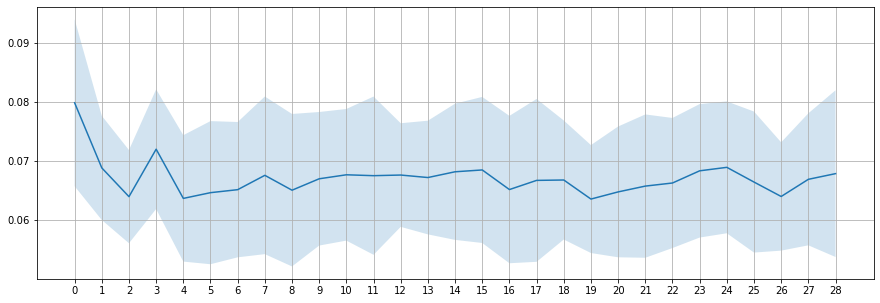

In [6]:
trails = run_trails(gen_hawkes, state, 20)
trails_mean = np.mean(trails,axis=0)
trails_std = np.std(trails,axis=0)
trails_x = np.arange(len(trails_mean))
plt.figure(figsize=(15,5))
plt.plot(trails_mean)
plt.fill_between(x=trails_x, y1=trails_mean-trails_std, y2=trails_mean+trails_std, alpha=0.2)
plt.grid()
plt.xticks(trails_x)
plt.show()